# Exploratory Data Analysis

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import re
import plotly.express as px
import seaborn as sns
import statsmodels.api as sm
import copy
from statsmodels.tsa.stattools import adfuller

In [2]:
data = pd.read_csv('./data/processed_data.csv', index_col=0)
data.index = pd.to_datetime(data.index)

In [3]:
data.head()

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,...,weather_description_proximity thunderstorm_Valencia,weather_description_scattered clouds_Valencia,weather_description_shower rain_Valencia,weather_description_sky is clear_Valencia,weather_description_smoke_Valencia,weather_description_thunderstorm_Valencia,weather_description_thunderstorm with heavy rain_Valencia,weather_description_thunderstorm with light rain_Valencia,weather_description_thunderstorm with rain_Valencia,weather_description_very heavy rain_Valencia
2015-01-01 00:00:00+01:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,43.0,...,0,0,0,1,0,0,0,0,0,0
2015-01-01 01:00:00+01:00,449.0,328.0,5196.0,4755.0,158.0,920.0,1009.0,1658.0,7096.0,43.0,...,0,0,0,1,0,0,0,0,0,0
2015-01-01 02:00:00+01:00,448.0,323.0,4857.0,4581.0,157.0,1164.0,973.0,1371.0,7099.0,43.0,...,0,0,0,1,0,0,0,0,0,0
2015-01-01 03:00:00+01:00,438.0,254.0,4314.0,4131.0,160.0,1503.0,949.0,779.0,7098.0,43.0,...,0,0,0,1,0,0,0,0,0,0
2015-01-01 04:00:00+01:00,428.0,187.0,4130.0,3840.0,156.0,1826.0,953.0,720.0,7097.0,43.0,...,0,0,0,1,0,0,0,0,0,0


## Summary Statistics

In [4]:
energy_cols = ['generation biomass', 'generation fossil brown coal/lignite', 'generation fossil gas', 'generation fossil hard coal', 'generation fossil oil', 'generation hydro pumped storage consumption', 'generation hydro run-of-river and poundage', 'generation hydro water reservoir', 'generation nuclear', 'generation other', 'generation other renewable', 'generation solar', 'generation waste']
target_variable = 'total load actual'
city = ['Barcelona', 'Bilbao', 'Madrid', 'Seville', 'Valencia']
weather_cols = [col for col in data.columns if any(col.endswith(f'_{c}') for c in city)]
weather_cols_no_description = [col for col in weather_cols if 'weather_description' not in col]
weather_cols_description = [col for col in weather_cols if 'weather_description' in col]

In [5]:
energy_summary = data[energy_cols+[target_variable]].describe().loc[['mean', 'std', 'min', '25%', '50%', '75%', 'max']]\
    .style.set_caption('Summary Statistics for Energy Data').format(precision=2).background_gradient(cmap='Blues')
display(energy_summary)

weather_summary = data[weather_cols_no_description].describe().loc[['mean', 'std', 'min', '25%', '50%', '75%', 'max']]\
    .style.set_caption('Summary Statistics for Weather Data').format(precision=2).background_gradient(cmap='Blues')
display(weather_summary)

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,generation other renewable,generation solar,generation waste,total load actual
mean,383.53,448.09,5622.70,4256.53,298.34,475.58,972.20,2605.53,6263.48,60.23,85.63,1432.82,269.42,28698.14
std,85.35,354.62,2201.51,1961.99,52.52,792.31,400.71,1835.18,840.27,20.24,14.08,1679.96,50.22,4575.72
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,18041.00
25%,333.00,0.00,4126.00,2527.00,263.00,0.00,637.00,1078.00,5759.00,53.00,73.00,71.00,240.00,24807.00
50%,367.00,509.00,4969.50,4475.00,300.00,68.00,906.00,2165.00,6564.00,57.00,88.00,616.00,279.00,28902.00
75%,433.00,757.00,6429.00,5839.00,330.00,616.00,1250.00,3758.00,7025.00,80.00,97.00,2579.00,310.00,32194.00
max,592.00,999.00,20034.00,8359.00,449.00,4523.00,2000.00,9728.00,7117.00,106.00,119.00,5792.00,357.00,41015.00


,temp_Barcelona,temp_min_Barcelona,temp_max_Barcelona,pressure_Barcelona,humidity_Barcelona,wind_speed_Barcelona,wind_deg_Barcelona,rain_1h_Barcelona,rain_3h_Barcelona,clouds_all_Barcelona,temp_Bilbao,temp_min_Bilbao,temp_max_Bilbao,pressure_Bilbao,humidity_Bilbao,wind_speed_Bilbao,wind_deg_Bilbao,rain_1h_Bilbao,rain_3h_Bilbao,snow_3h_Bilbao,clouds_all_Bilbao,temp_Madrid,temp_min_Madrid,temp_max_Madrid,pressure_Madrid,humidity_Madrid,wind_speed_Madrid,wind_deg_Madrid,rain_1h_Madrid,rain_3h_Madrid,snow_3h_Madrid,clouds_all_Madrid,temp_Seville,temp_min_Seville,temp_max_Seville,pressure_Seville,humidity_Seville,wind_speed_Seville,wind_deg_Seville,rain_1h_Seville,rain_3h_Seville,clouds_all_Seville,temp_Valencia,temp_min_Valencia,temp_max_Valencia,pressure_Valencia,humidity_Valencia,wind_speed_Valencia,wind_deg_Valencia,rain_1h_Valencia,rain_3h_Valencia,snow_3h_Valencia,clouds_all_Valencia
mean,289.87,288.62,291.04,1017.23,73.83,2.78,187.66,0.11,0.00,22.71,286.44,284.99,288.09,1017.48,78.73,1.96,159.91,0.12,0.00,0.02,43.44,288.28,287.05,289.37,1011.78,58.73,2.43,173.36,0.04,0.00,0.00,20.66,293.17,291.26,296.00,1018.53,63.78,2.48,151.89,0.04,0.00,14.17,290.78,290.23,291.36,1015.98,65.09,2.69,160.80,0.03,0.00,0.00,20.74
std,6.72,6.46,7.29,11.02,17.72,2.00,108.56,0.67,0.00,27.33,6.80,6.82,6.99,9.82,16.71,1.87,122.86,0.37,0.01,0.50,33.74,9.33,9.18,9.68,20.24,24.88,1.97,121.95,0.20,0.00,0.01,29.66,8.08,8.26,9.08,6.86,22.88,1.87,104.33,0.22,0.00,26.17,7.23,7.09,7.52,11.94,19.68,2.49,120.41,0.26,0.00,0.01,25.60
min,262.24,262.24,262.24,0.00,0.00,0.00,0.00,0.00,0.00,0.00,266.85,264.15,268.98,961.00,11.00,0.00,0.00,0.00,0.00,0.00,0.00,264.13,264.13,264.13,927.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,271.05,269.15,272.06,986.00,7.00,0.00,0.00,0.00,0.00,0.00,268.83,268.83,268.83,969.00,8.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,284.71,284.15,285.15,1014.00,62.00,1.00,100.00,0.00,0.00,0.00,281.45,280.15,283.15,1013.00,67.00,1.00,31.00,0.00,0.00,0.00,6.00,281.15,280.15,282.15,1013.00,38.00,1.00,50.00,0.00,0.00,0.00,0.00,287.33,285.15,289.15,1014.00,46.00,1.00,50.00,0.00,0.00,0.00,285.15,285.15,285.65,1012.00,51.00,1.00,50.00,0.00,0.00,0.00,0.00
50%,289.41,288.15,290.15,1017.00,76.00,2.00,210.00,0.00,0.00,20.00,286.17,284.85,288.15,1019.00,82.00,1.00,150.00,0.00,0.00,0.00,40.00,286.93,286.14,288.15,1017.00,59.00,2.00,190.00,0.00,0.00,0.00,0.00,292.44,290.15,295.15,1018.00,67.00,2.00,175.00,0.00,0.00,0.00,290.19,290.15,291.15,1017.00,67.00,2.00,130.00,0.00,0.00,0.00,20.00
75%,295.15,293.27,297.04,1021.00,87.00,4.00,280.00,0.00,0.00,36.00,291.04,290.15,292.51,1024.00,93.00,3.00,290.00,0.00,0.00,0.00,75.00,294.95,293.71,296.15,1022.00,81.00,3.00,270.00,0.00,0.00,0.00,40.00,298.88,296.80,303.15,1023.00,83.00,3.00,230.00,0.00,0.00,20.00,296.15,295.37,297.15,1021.00,82.00,4.00,280.00,0.00,0.00,0.00,20.00
max,309.15,307.15,315.37,1039.00,100.00,15.00,360.00,12.00,0.10,100.00,312.47,312.04,318.71,1042.00,100.00,15.00,360.00,3.00,2.31,21.50,100.00,313.33,312.15,316.48,1042.00,100.00,18.00,360.00,3.00,0.10,1.05,100.00,315.60,315.15,321.15,1048.00,100.00,15.00,360.00,3.00,0.10,100.00,311.15,311.15,314.82,1087.00,100.00,64.00,360.00,12.00,0.10,1.12,100.00


## Investigate patterns and trends in energy consumption and weather data

## Plot Overall Trends and Patterns of the data

## Energy Generation Trends and Patterns

In [6]:
data[energy_cols]

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,generation other renewable,generation solar,generation waste
2015-01-01 00:00:00+01:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,43.0,73.0,49.0,196.0
2015-01-01 01:00:00+01:00,449.0,328.0,5196.0,4755.0,158.0,920.0,1009.0,1658.0,7096.0,43.0,71.0,50.0,195.0
2015-01-01 02:00:00+01:00,448.0,323.0,4857.0,4581.0,157.0,1164.0,973.0,1371.0,7099.0,43.0,73.0,50.0,196.0
2015-01-01 03:00:00+01:00,438.0,254.0,4314.0,4131.0,160.0,1503.0,949.0,779.0,7098.0,43.0,75.0,50.0,191.0
2015-01-01 04:00:00+01:00,428.0,187.0,4130.0,3840.0,156.0,1826.0,953.0,720.0,7097.0,43.0,74.0,42.0,189.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-31 19:00:00+01:00,297.0,0.0,7634.0,2628.0,178.0,1.0,1135.0,4836.0,6073.0,63.0,95.0,85.0,277.0
2018-12-31 20:00:00+01:00,296.0,0.0,7241.0,2566.0,174.0,1.0,1172.0,3931.0,6074.0,62.0,95.0,33.0,280.0
2018-12-31 21:00:00+01:00,292.0,0.0,7025.0,2422.0,168.0,50.0,1148.0,2831.0,6076.0,61.0,94.0,31.0,286.0
2018-12-31 22:00:00+01:00,293.0,0.0,6562.0,2293.0,163.0,108.0,1128.0,2068.0,6075.0,61.0,93.0,31.0,287.0


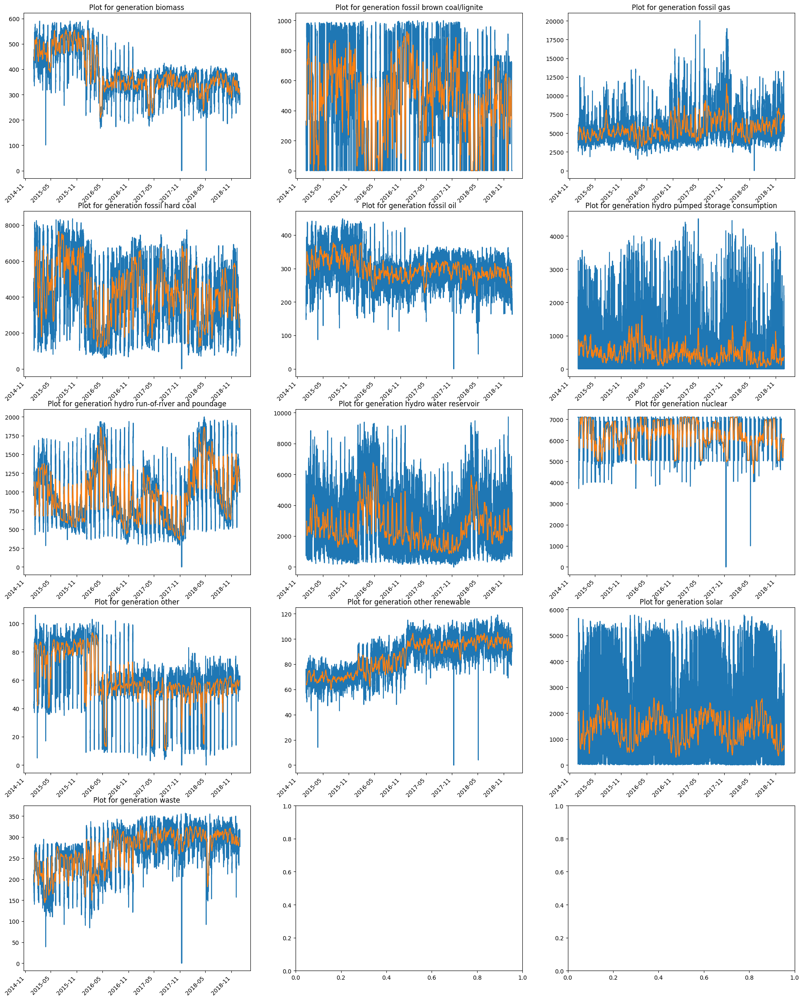

In [7]:
fig, axes = plt.subplots(5, 3, figsize=(24, 30))

for idx, feature in enumerate(energy_cols):
    row = idx // 3
    col = idx % 3
    ax = axes[row, col]
    ax.plot(data[feature],)
    ax.plot(data.rolling(24*7, center=True).mean()[feature])
    ax.xaxis.set_major_locator(mdates.MonthLocator(interval=6))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
    ax.set_title("Plot for " + feature)
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')

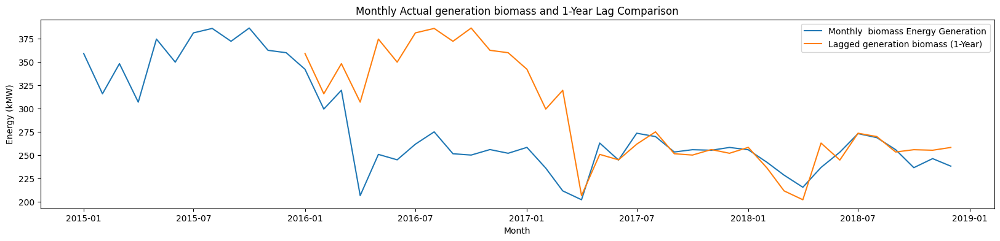

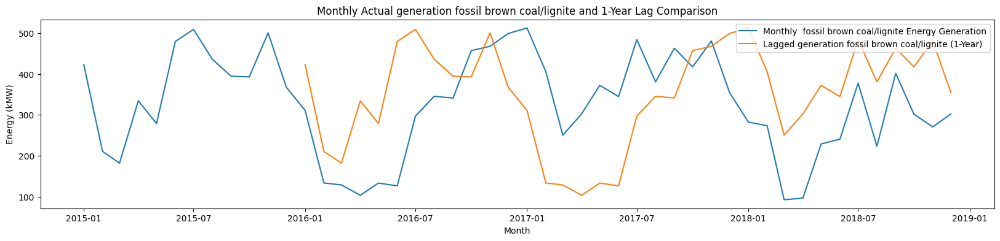

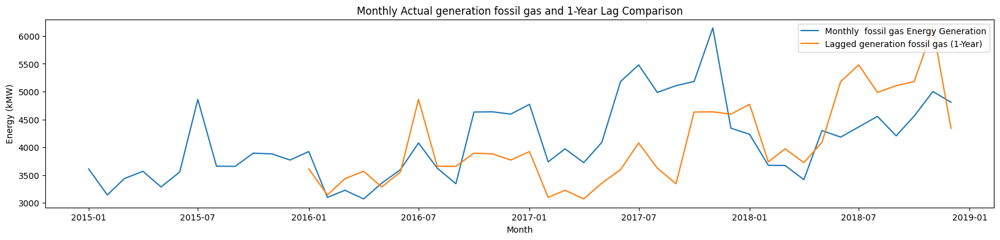

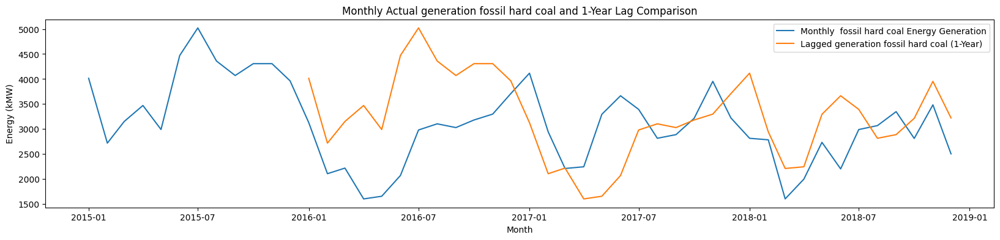

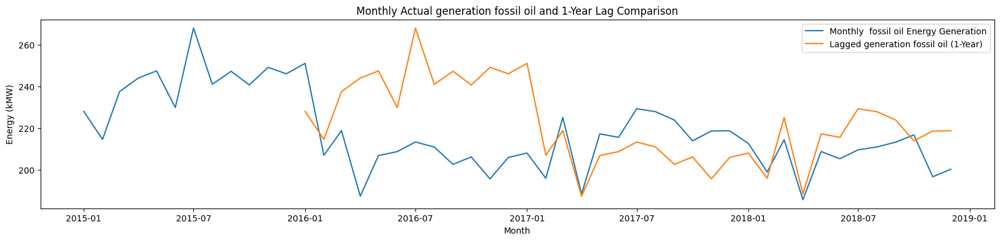

...

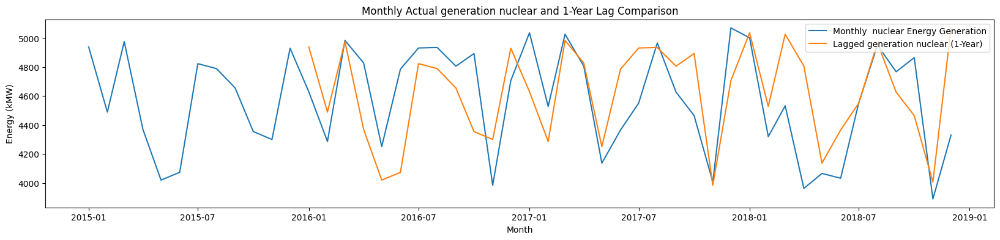

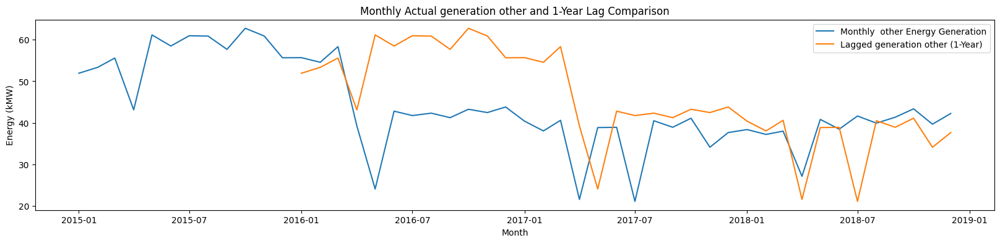

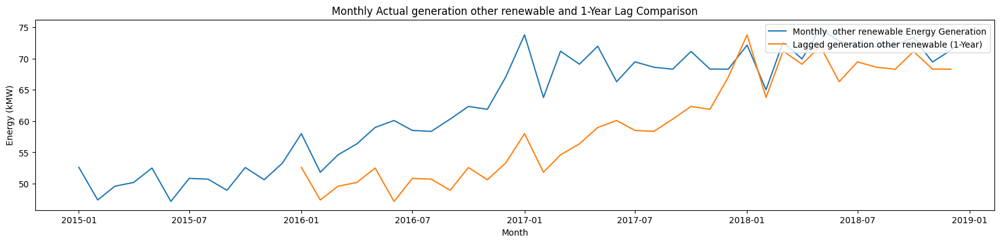

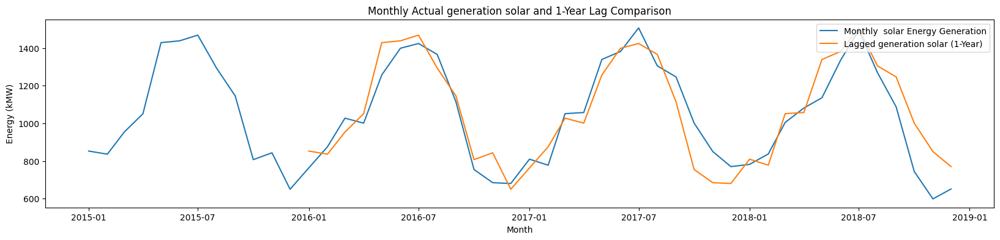

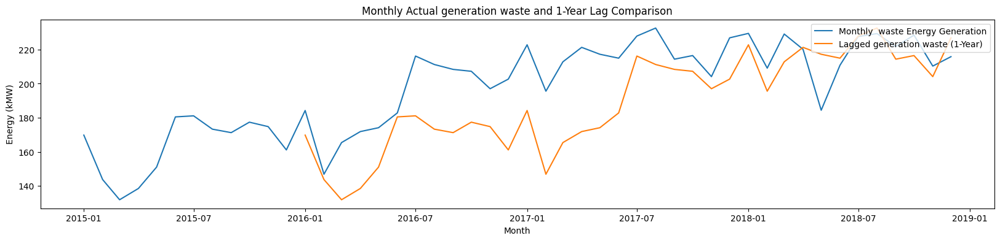

In [8]:
for idx, feature in enumerate(energy_cols):
    monthly_sum = data[feature].resample('ME').sum()/1000
    monthly_sum.index = monthly_sum.index - pd.offsets.MonthEnd(1) + pd.offsets.MonthBegin(1)
    lagged_monthly_sum = monthly_sum.shift(12)

    fig, ax = plt.subplots(figsize=(20, 4))
    ax.plot(monthly_sum)
    ax.plot(lagged_monthly_sum)
    ax.set_title(f"Monthly Actual {feature} and 1-Year Lag Comparison")
    ax.legend([f"Monthly {feature.replace('generation', '')} Energy Generation", f'Lagged {feature} (1-Year)'], loc='upper right')
    ax.set_ylabel('Energy (kMW)')
    ax.set_xlabel('Month')

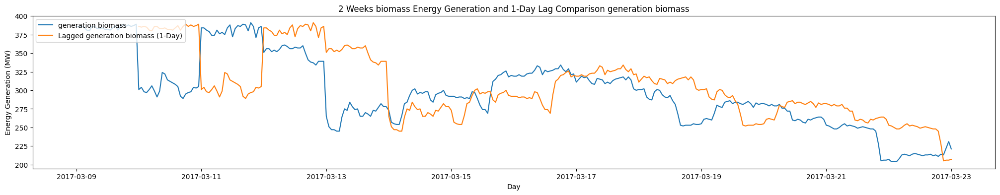

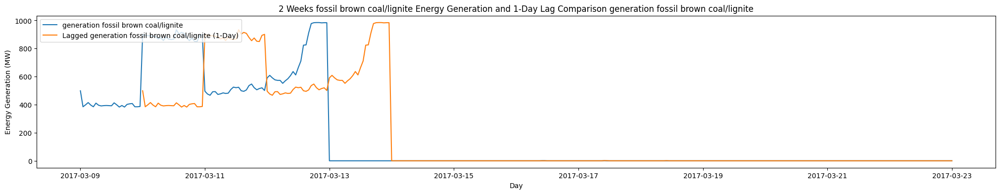

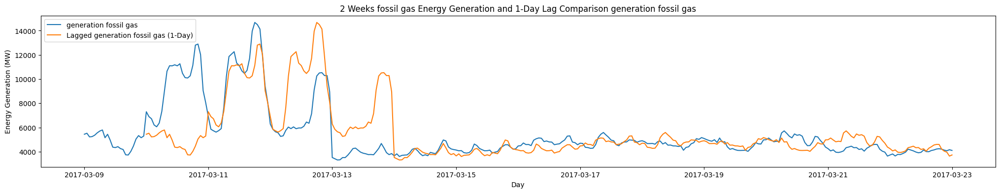

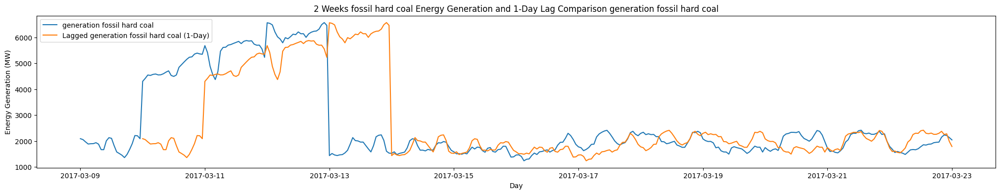

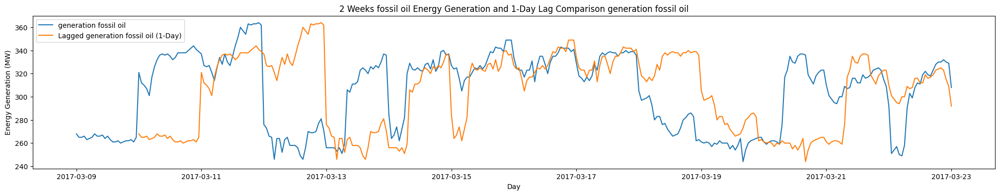

...

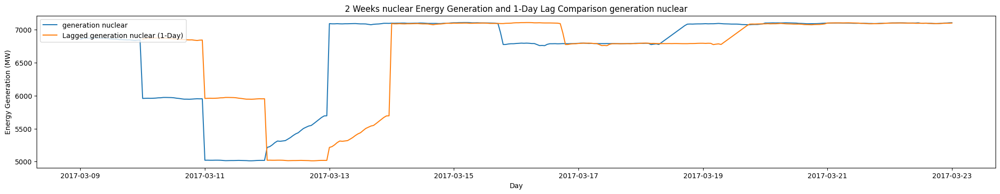

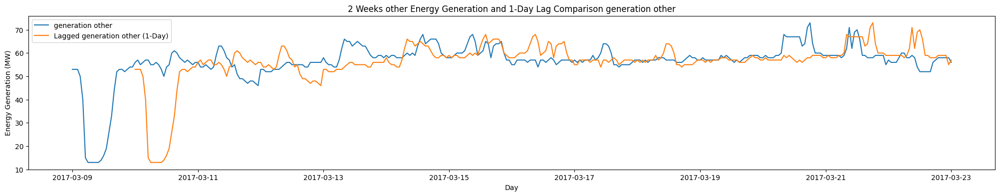

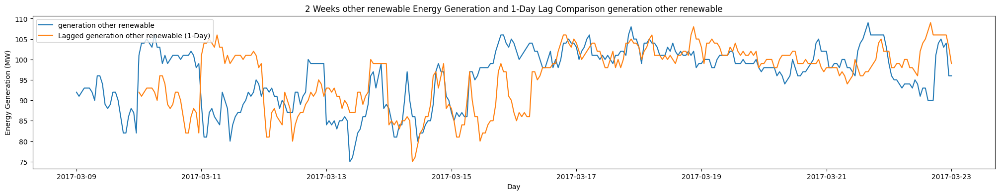

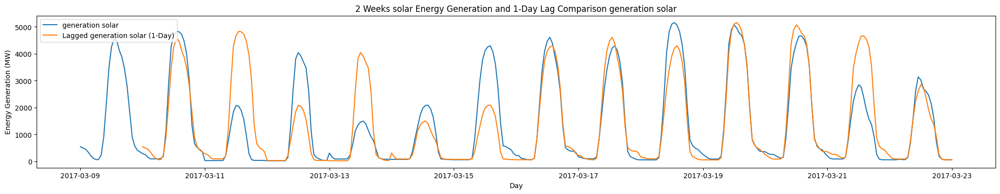

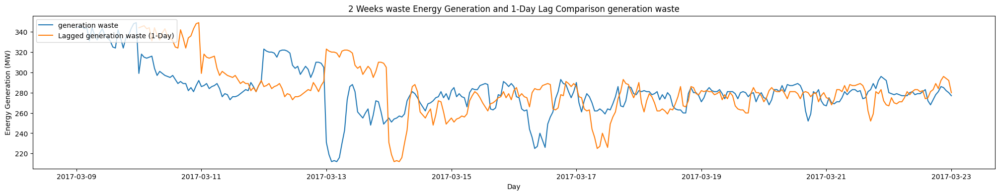

In [9]:
short_period_data = data[(data.index <='2017-03-23 00:00:00+01:00') & (data.index >='2017-03-09 00:00:00+01:00')]
shift_short_period_data = short_period_data.shift(24)
for idx, feature in enumerate(energy_cols):
    fig, ax = plt.subplots(figsize=(25, 4))
    ax.plot(short_period_data[feature])
    ax.plot(shift_short_period_data[feature])
    ax.set_title(f"2 Weeks {feature.replace('generation ', '')} Energy Generation and 1-Day Lag Comparison "+feature)
    ax.legend([feature, f'Lagged {feature} (1-Day)'], loc='upper left')
    ax.set_ylabel('Energy Generation (MW)')
    ax.set_xlabel('Day')
    # plt.savefig(f"2_Weeks_{feature.replace('/', '_')}_and_1-Day_Lag_Comparison.jpg", dpi=300)

It shows daily patterns in some energy genertaion

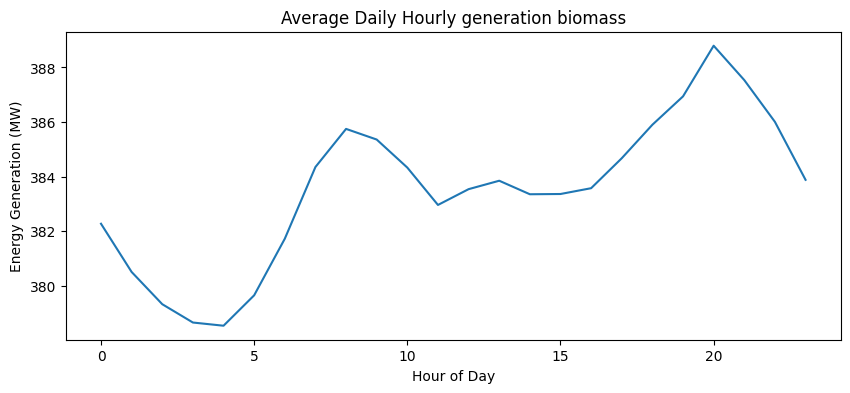

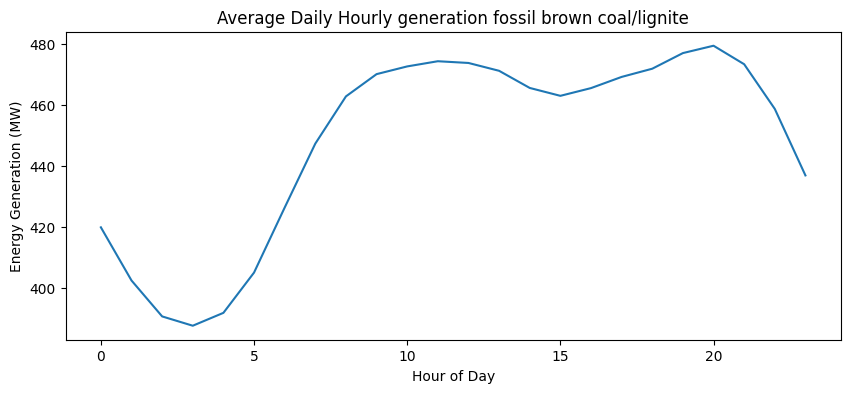

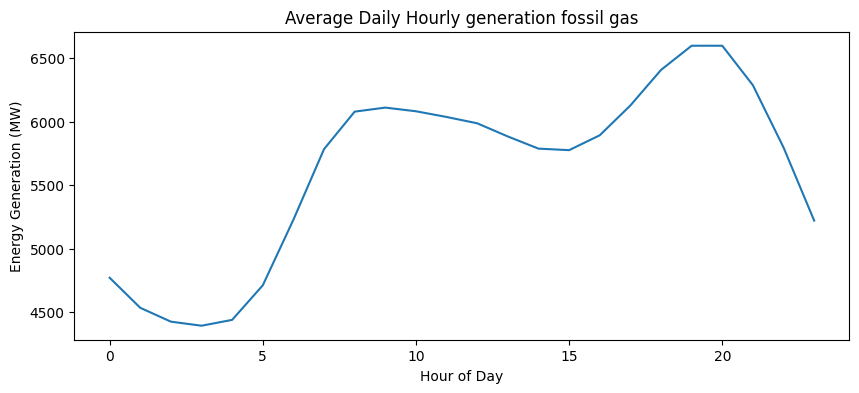

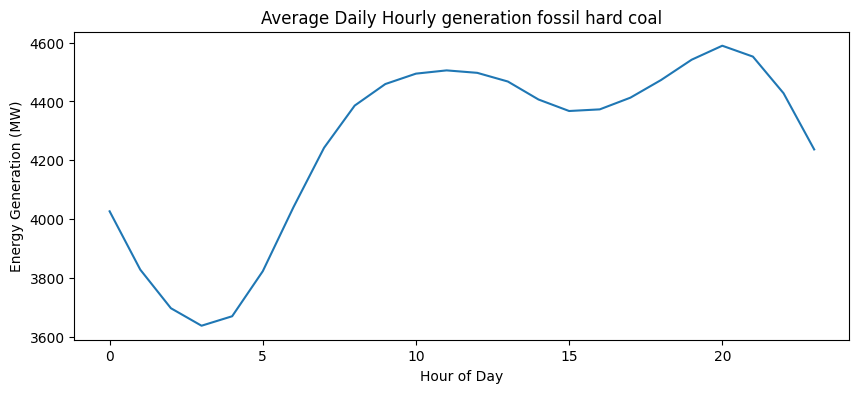

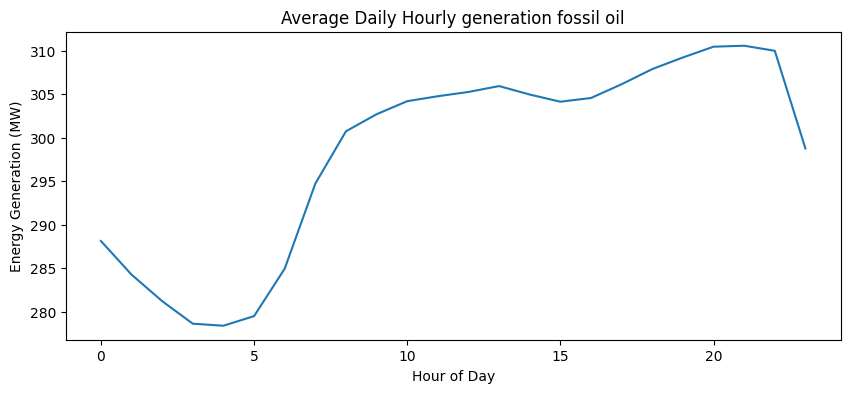

...

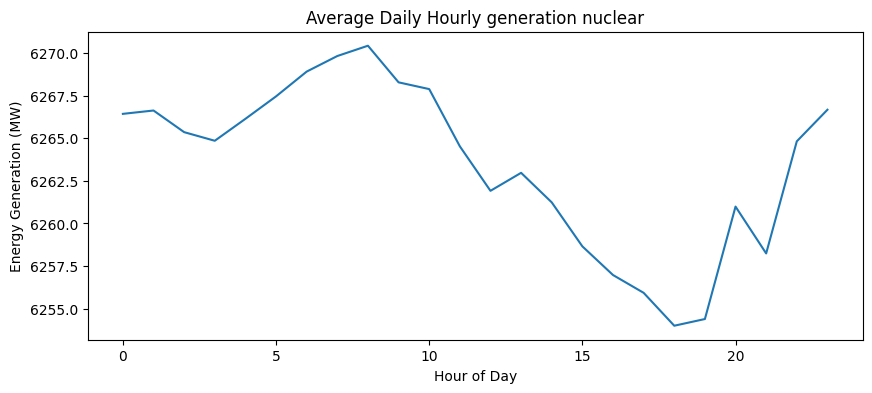

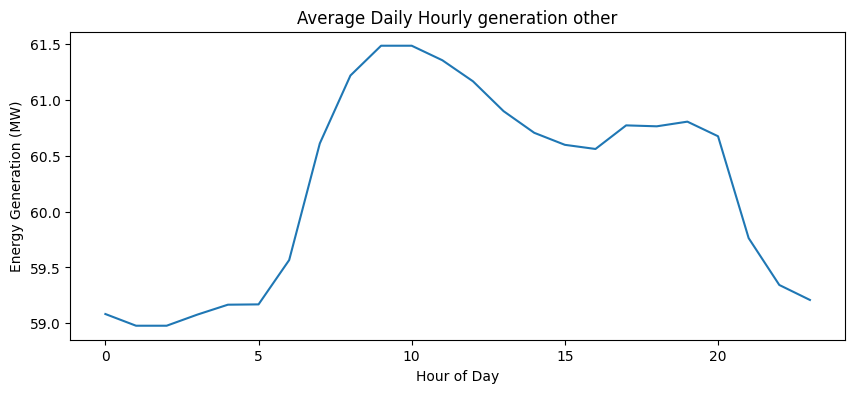

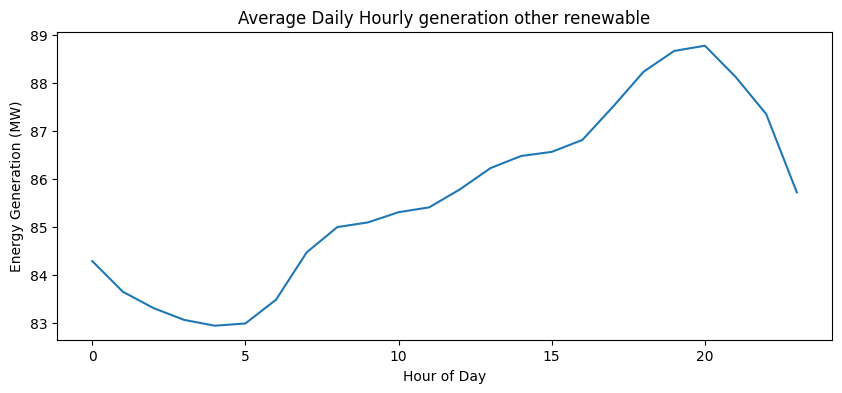

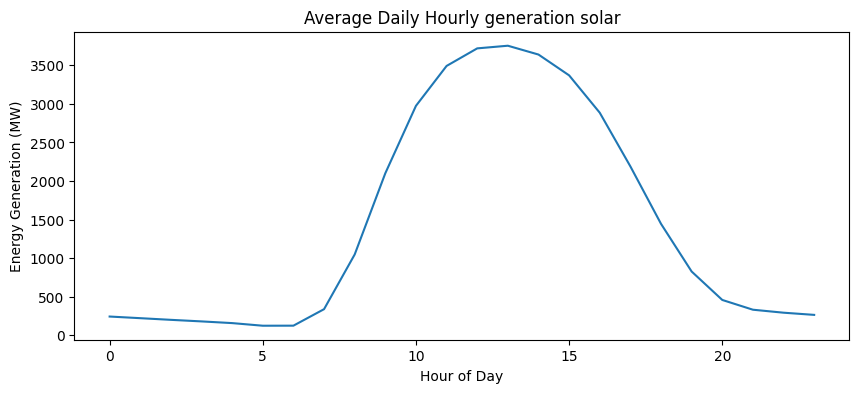

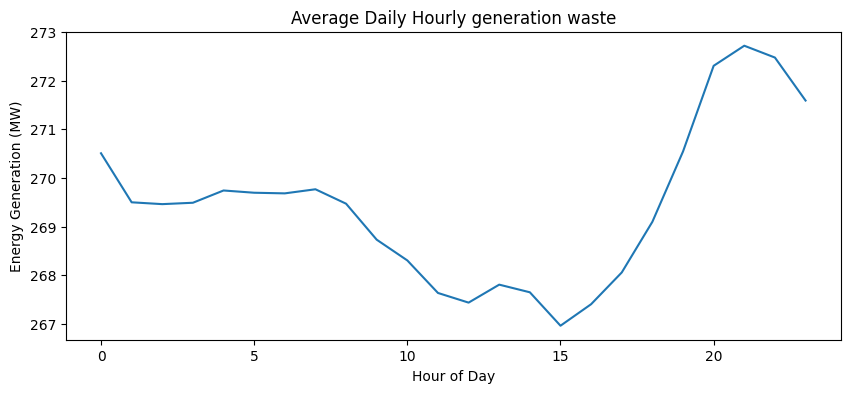

In [10]:
#TODO: Only show those with patterns

for idx, feature in enumerate(energy_cols):
    fig, ax = plt.subplots(figsize=(10, 4))
    ax.plot(data[feature].groupby(data.index.hour).mean())
    ax.set_xlabel("Hour of Day")
    ax.set_ylabel(f"Energy Generation (MW)")
    ax.set_title(f"Average Daily Hourly {feature}")


#### Compare Energy Generation

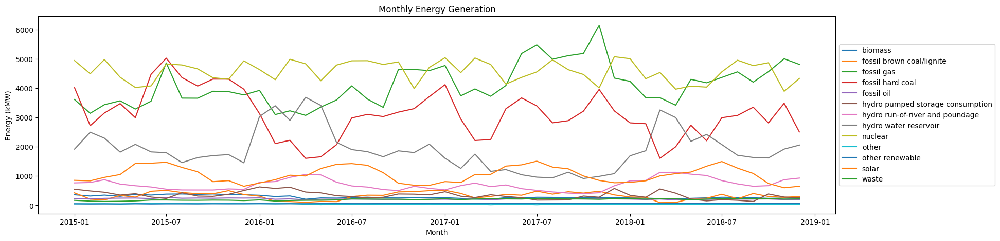

In [11]:
fig, ax = plt.subplots(figsize=(20, 5))

for idx, feature in enumerate(energy_cols):
    monthly_sum = data[feature].resample('ME').sum()/1000
    monthly_sum.index = monthly_sum.index - pd.offsets.MonthEnd(1) + pd.offsets.MonthBegin(1)
    
    ax.plot(monthly_sum, label=feature.replace("generation ", ""))
    ax.set_title(f"Monthly Energy Generation")
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    ax.set_ylabel('Energy (kMW)')
    ax.set_xlabel('Month')
    #ax.legend([f'Monthly {feature}', f'Lagged {feature} (1-Year)'], loc='upper right')

[Text(0, 0, '2015-01'),
 Text(6, 0, '2015-07'),
 Text(12, 0, '2016-01'),
 Text(18, 0, '2016-07'),
 Text(24, 0, '2017-01'),
 Text(30, 0, '2017-07'),
 Text(36, 0, '2018-01'),
 Text(42, 0, '2018-07')]

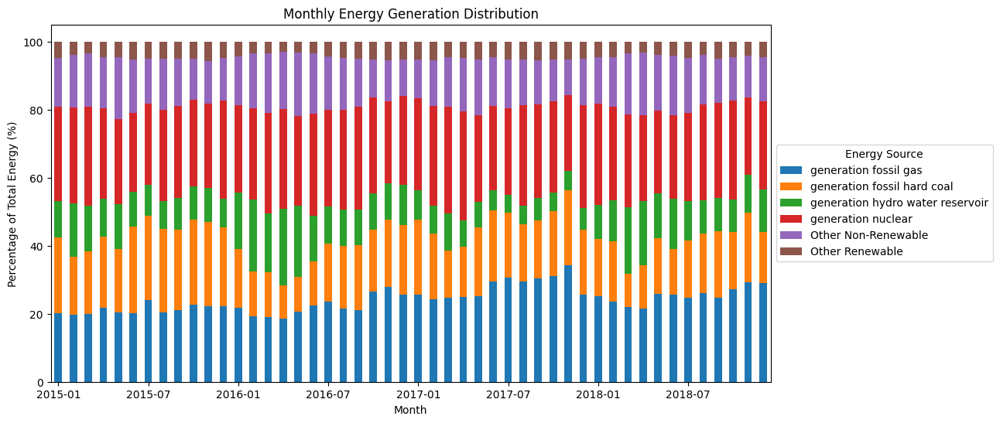

In [12]:
monthly_sum = data[energy_cols].resample('ME').sum()/1000
monthly_sum.index = monthly_sum.index - pd.offsets.MonthEnd(1) + pd.offsets.MonthBegin(1)
monthly_percent = monthly_sum.div(monthly_sum.sum(axis=1), axis=0)*100

other_nonrenewable_cols = ['generation biomass', 'generation hydro pumped storage consumption', 'generation hydro run-of-river and poundage', 'generation other renewable', 'generation solar']
other_renewable_cols = ['generation fossil brown coal/lignite', 'generation fossil oil', 'generation other', 'generation waste']

simplified_monthly_percent = monthly_percent.loc[:, (monthly_percent > 5).all(axis=0)].copy()
simplified_monthly_percent.loc[:, 'Other Non-Renewable'] = (monthly_percent[other_nonrenewable_cols].sum(axis=1))
simplified_monthly_percent.loc[:, 'Other Renewable'] = (monthly_percent[other_renewable_cols].sum(axis=1))
simplified_monthly_percent.index = simplified_monthly_percent.index.strftime('%Y-%m')

fig, ax = plt.subplots(figsize=(12, 6))

simplified_monthly_percent.plot(
    kind='bar',
    stacked=True,
    ax=ax
)

ax.set_title("Monthly Energy Generation Distribution")
ax.legend(title="Energy Source", loc='center left', bbox_to_anchor=(1, 0.5))
ax.set_ylabel("Percentage of Total Energy (%)")
ax.set_xlabel("Month")
tick_positions = range(0, len(simplified_monthly_percent), 6)
ax.set_xticks(tick_positions)
ax.set_xticklabels(simplified_monthly_percent.index[tick_positions], rotation=0)
# ax.xaxis.set_major_locator(mdates.MonthLocator(interval=6))
# ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))


In [13]:
simplified_monthly_percent.columns

Index(['generation fossil gas', 'generation fossil hard coal',
       'generation hydro water reservoir', 'generation nuclear',
       'Other Non-Renewable', 'Other Renewable'],
      dtype='object')

In [14]:
np.mean(simplified_monthly_percent['generation hydro water reservoir'])

np.float64(11.308171419570868)

In [15]:
np.mean(simplified_monthly_percent['generation fossil hard coal'])

np.float64(18.250050951780086)

#### Sum of Energy Generation

In [16]:
renewable_energy_cols = ['generation biomass', 'generation hydro pumped storage consumption', 'generation hydro run-of-river and poundage', 'generation hydro water reservoir', 'generation other renewable', 'generation solar']
non_renewable_energy_cols = ['generation nuclear', 'generation other', 'generation fossil brown coal/lignite', 'generation fossil gas', 'generation fossil hard coal', 'generation fossil oil', 'generation waste']

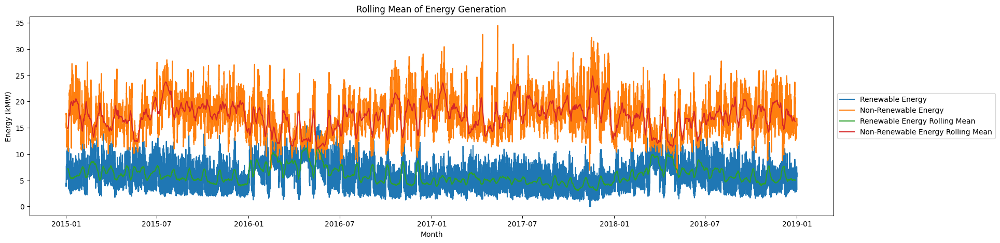

In [17]:
fig, ax = plt.subplots(figsize=(20, 5))

ax.plot(data[renewable_energy_cols].sum(axis=1)/1000, label='Renewable Energy')
ax.plot(data[non_renewable_energy_cols].sum(axis=1)/1000, label='Non-Renewable Energy')
ax.plot(data[renewable_energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000, label='Renewable Energy Rolling Mean')
ax.plot(data[non_renewable_energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000, label='Non-Renewable Energy Rolling Mean')
ax.set_title(f"Rolling Mean of Energy Generation")
ax.set_ylabel('Energy (kMW)')
ax.set_xlabel('Month')
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

### Target Variable

In [18]:
feature = 'total load actual'

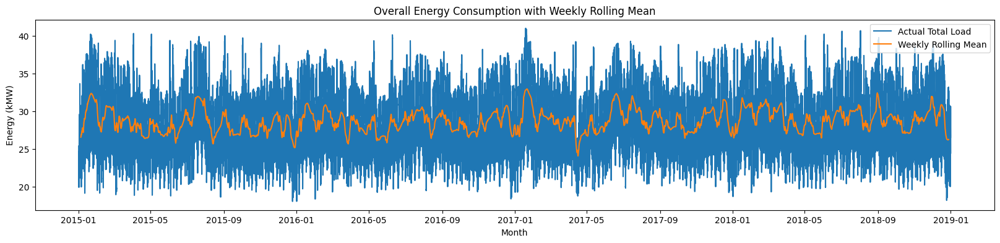

In [19]:
fig, ax = plt.subplots(figsize=(20, 4))
ax.plot(data[feature]/1000)
ax.plot(data.rolling(24*7, center=True).mean()[feature]/1000)
ax.set_title("Overall Energy Consumption with Weekly Rolling Mean")
ax.xaxis.set_major_locator(mdates.MonthLocator(interval=4))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
ax.legend(['Actual Total Load', 'Weekly Rolling Mean'])
ax.set_ylabel('Energy (kMW)')
ax.set_xlabel('Month')
plt.show()

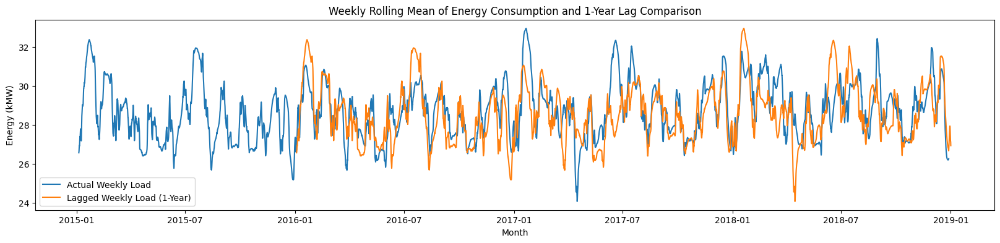

In [20]:
weekly_data = data.rolling(24*7, center=True).mean()[feature]/1000
lagged_weekly_data = weekly_data.shift(24*7*52)

fig, ax = plt.subplots(figsize=(20, 4))
ax.plot(weekly_data)
ax.plot(lagged_weekly_data)
ax.set_title("Weekly Rolling Mean of Energy Consumption and 1-Year Lag Comparison")
ax.legend(['Actual Weekly Load', 'Lagged Weekly Load (1-Year)'])
ax.set_ylabel('Energy (kMW)')
ax.set_xlabel('Month')
plt.show()

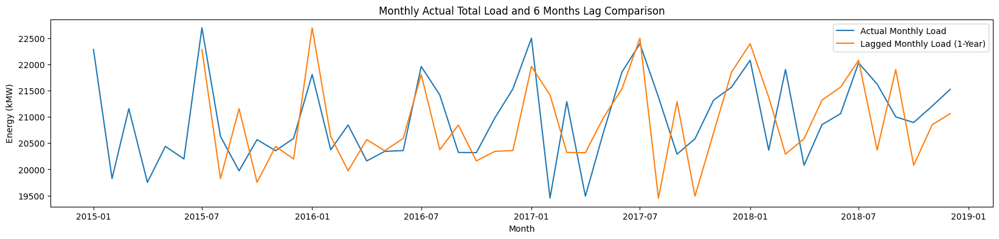

In [21]:
monthly_sum = data[feature].resample('ME').sum()/1000
monthly_sum.index = monthly_sum.index - pd.offsets.MonthEnd(1) + pd.offsets.MonthBegin(1)
lagged_monthly_sum = monthly_sum.shift(6)

fig, ax = plt.subplots(figsize=(20, 4))
ax.plot(monthly_sum)
ax.plot(lagged_monthly_sum)
ax.set_title("Monthly Actual Total Load and 6 Months Lag Comparison")
ax.legend(['Actual Monthly Load', 'Lagged Monthly Load (1-Year)'])
ax.set_ylabel('Energy (kMW)')
ax.set_xlabel('Month')
plt.show()

#### Monthly Actual Total Load and 1-Year Lag Comparison

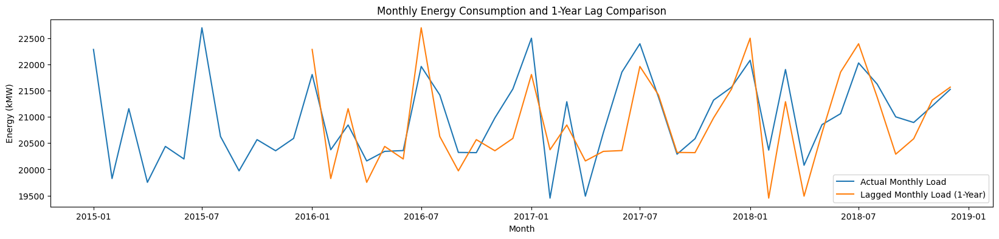

In [22]:
monthly_sum = data[feature].resample('ME').sum()/1000
monthly_sum.index = monthly_sum.index - pd.offsets.MonthEnd(1) + pd.offsets.MonthBegin(1)
lagged_monthly_sum = monthly_sum.shift(12)

fig, ax = plt.subplots(figsize=(20, 4))
ax.plot(monthly_sum)
ax.plot(lagged_monthly_sum)
ax.set_title("Monthly Energy Consumption and 1-Year Lag Comparison")
ax.legend(['Actual Monthly Load', 'Lagged Monthly Load (1-Year)'])
ax.set_ylabel('Energy (kMW)')
ax.set_xlabel('Month')
plt.show()

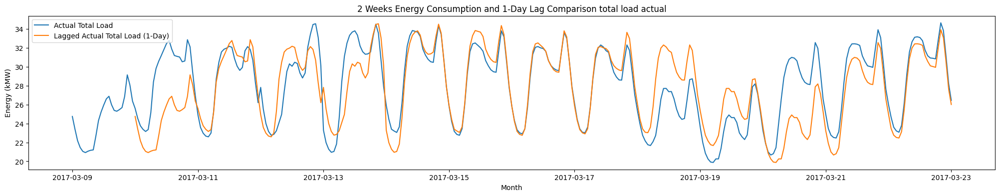

In [23]:
short_period_data = data[(data.index <='2017-03-23 00:00:00+01:00') & (data.index >='2017-03-09 00:00:00+01:00')]/1000
shift_short_period_data = short_period_data.shift(24)
fig, ax = plt.subplots(figsize=(25, 4))
ax.plot(short_period_data[feature])
ax.plot(shift_short_period_data[feature])
ax.set_title("2 Weeks Energy Consumption and 1-Day Lag Comparison "+feature)
ax.legend(['Actual Total Load', 'Lagged Actual Total Load (1-Day)'], loc='upper left')
ax.set_ylabel('Energy (kMW)')
ax.set_xlabel('Month')
plt.show()

It shows a daily pattern in actual load

#### Average Daily Hourly Total Load

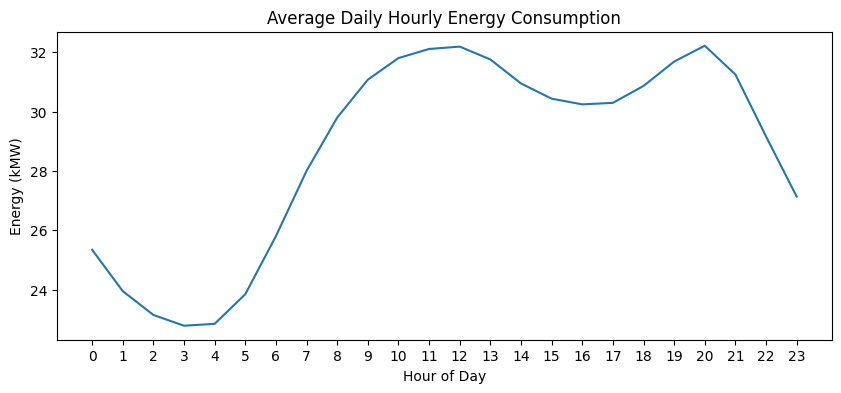

In [24]:
data[feature].groupby(data.index.hour).transform('mean')

fig, ax = plt.subplots(figsize=(10, 4))
ax.plot(data[feature].groupby(data.index.hour).mean()/1000)
ax.set_xlabel("Hour of Day")
ax.set_ylabel("Energy (kMW)")
ax.set_title("Average Daily Hourly Energy Consumption")
ax.set_xticks(np.arange(24))
ax.set_xticklabels(np.arange(24).astype(str))

plt.show()

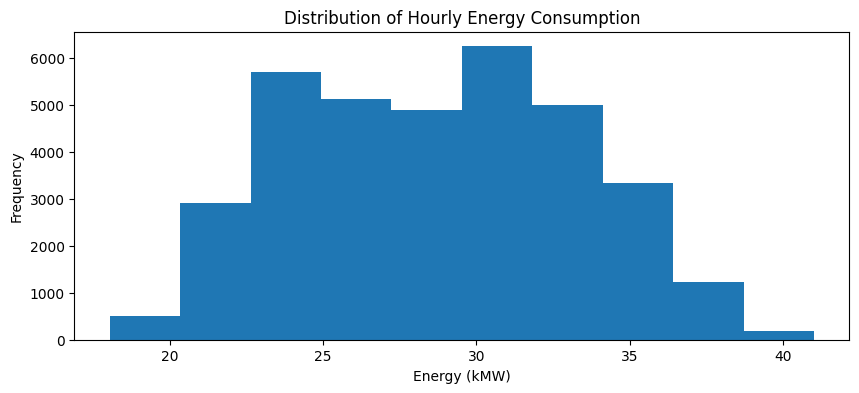

In [25]:
fig, ax = plt.subplots(figsize=(10, 4))
ax.hist(data[feature]/1000)
ax.set_xlabel("Energy (kMW)")
ax.set_ylabel("Frequency")
ax.set_title("Distribution of Hourly Energy Consumption")
plt.show()

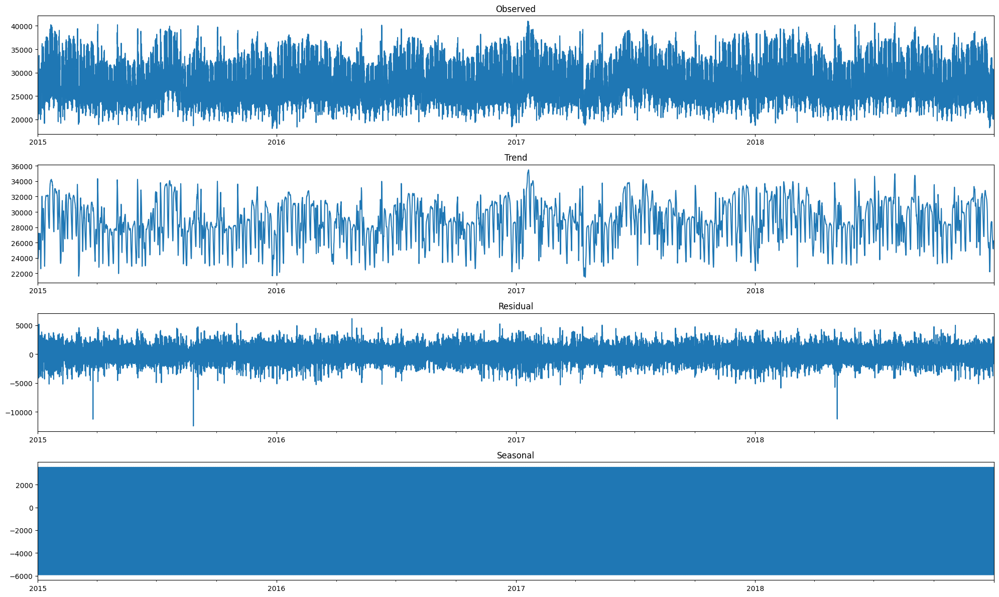

In [26]:
decompose_result = sm.tsa.seasonal_decompose(data[feature], model='additive')

fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(20, 12))
decompose_result.observed.plot(ax=ax1, title='Observed')
decompose_result.trend.plot(ax=ax2, title='Trend')
decompose_result.resid.plot(ax=ax3, title='Residual')
decompose_result.seasonal.plot(ax=ax4, title='Seasonal')
plt.tight_layout()
plt.show()

### Energy Generation vs Load

In [27]:
feature

'total load actual'

Text(0, 0.5, 'Energy (kMW)')

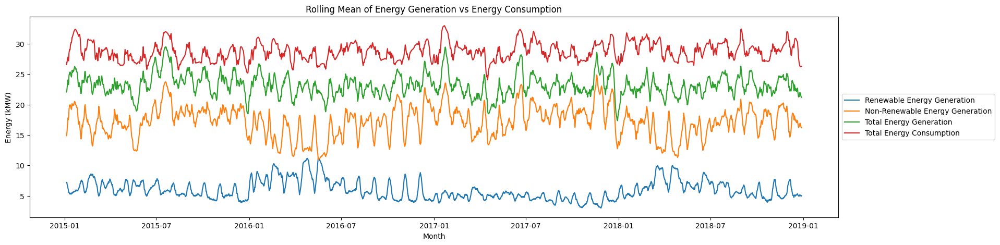

In [28]:
fig, ax = plt.subplots(figsize=(20, 5))

ax.plot(data[renewable_energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000, label='Renewable Energy Generation')
ax.plot(data[non_renewable_energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000, label='Non-Renewable Energy Generation')
ax.plot(data[energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000, label='Total Energy Generation')
ax.plot(data[feature].rolling(24*7, center=True).mean()/1000, label='Total Energy Consumption')
ax.set_title(f"Rolling Mean of Energy Generation vs Energy Consumption")
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
ax.set_xlabel("Month")
ax.set_ylabel("Energy (kMW)")

In [29]:
print("Renewable Energy Generation", np.mean(data[renewable_energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000))
print("Non-Renewable Energy Generation", np.mean(data[non_renewable_energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000))
print("Total Energy Generation", np.mean(data[energy_cols].sum(axis=1).rolling(24*7, center=True).mean()/1000))
print("Total Energy Consumption", np.mean(data[feature].rolling(24*7, center=True).mean()/1000))

Renewable Energy Generation 5.954204123495402
Non-Renewable Energy Generation 17.230512428582347
Total Energy Generation 23.184716552077745
Total Energy Consumption 28.710605294933647


### Weather

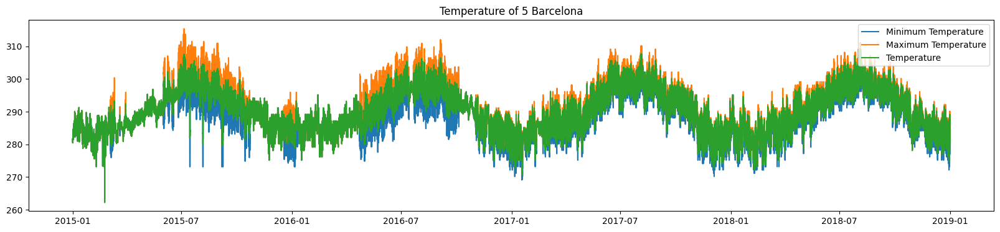

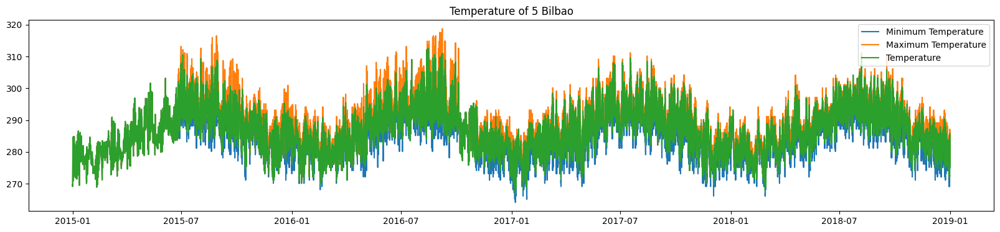

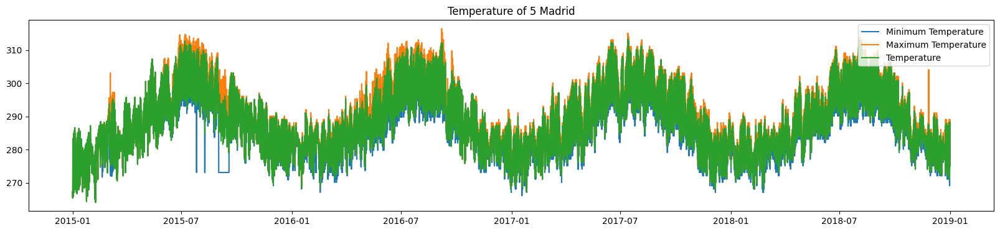

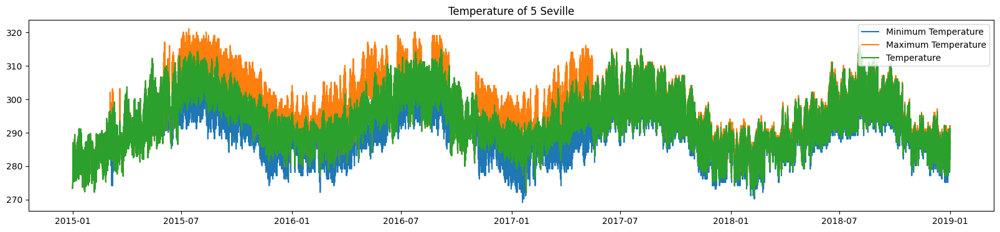

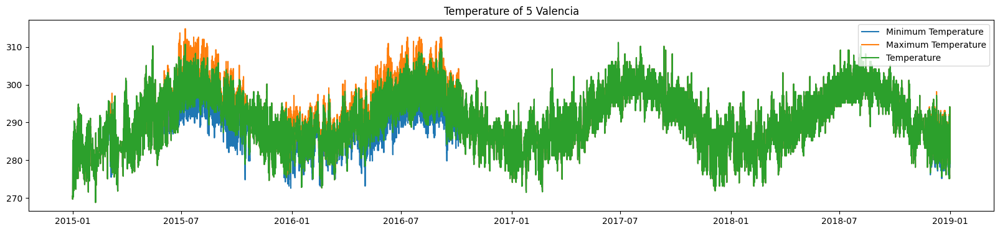

In [30]:
for c in city:
    fig, ax = plt.subplots(figsize=(20, 4))
    
    ax.plot(data[f"temp_min_{c}"], label="Minimum Temperature")
    ax.plot(data[f"temp_max_{c}"], label="Maximum Temperature")
    ax.plot(data[f"temp_{c}"], label="Temperature")
    ax.set_title(f"Temperature of 5 {c}")
    ax.legend(loc='upper right')

/var/folders/8f/xm08m3255q9b0j33fhp73q_w0000gn/T/ipykernel_17092/1005830150.py:9: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(loc='upper right')


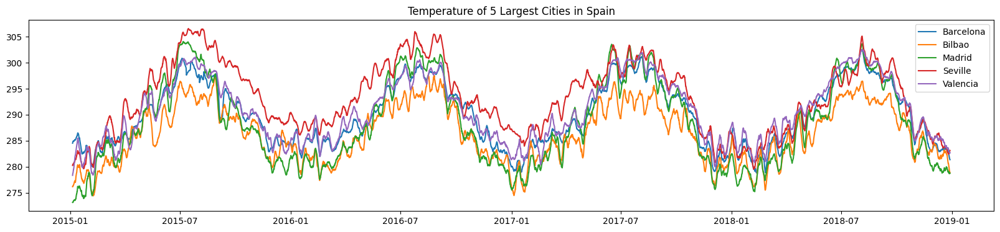

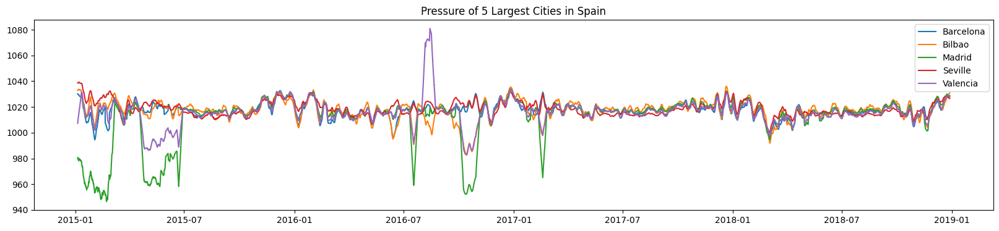

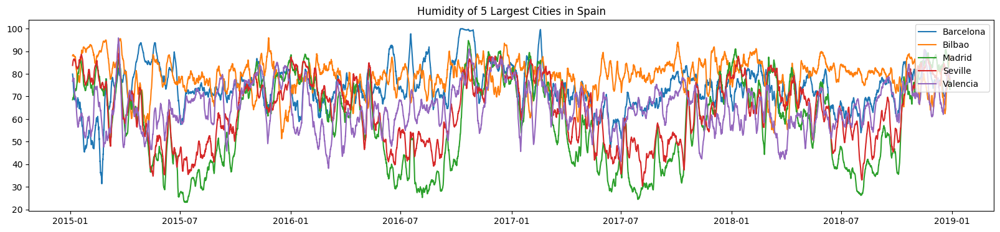

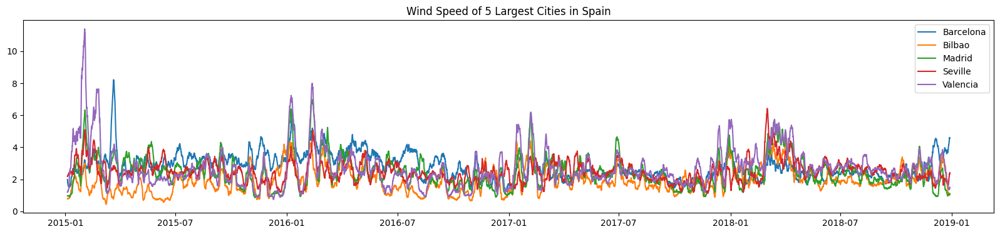

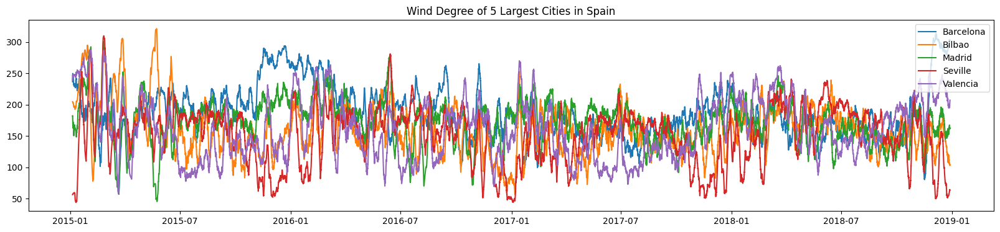

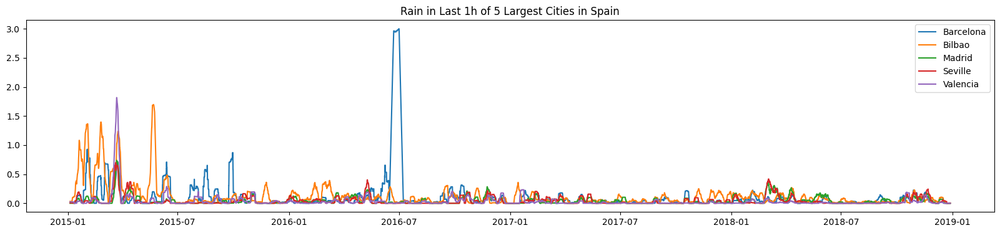

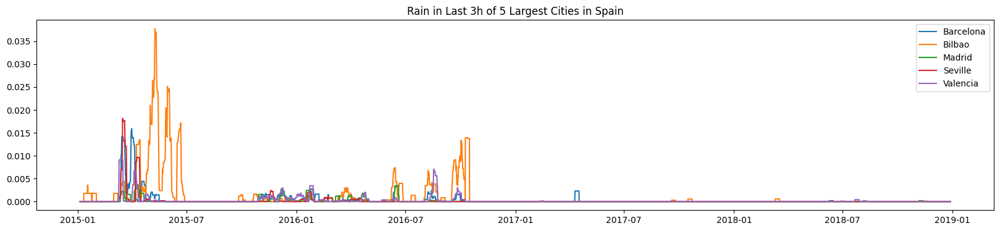

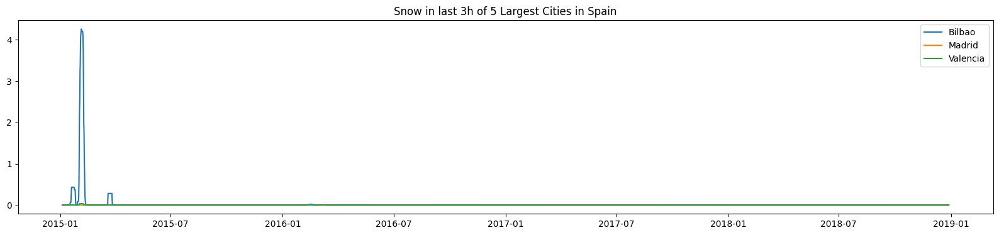

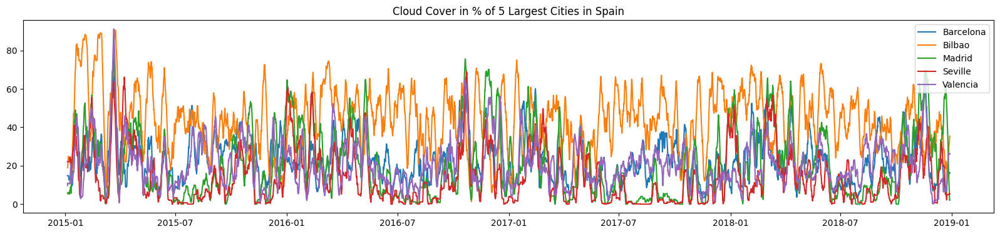

In [31]:
weathers = ['temp', 'pressure', 'humidity', 'wind_speed', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_3h', 'clouds_all']
weather_titles = ['Temperature', 'Pressure', 'Humidity', 'Wind Speed', 'Wind Degree', 'Rain in Last 1h', 'Rain in Last 3h', 'Snow in last 3h', 'Cloud Cover in %']
for i, weather in enumerate(weathers):
    fig, ax = plt.subplots(figsize=(20, 4))
    for c in city:
        if f"{weather}_{c}" in data.columns:
            ax.plot(data[f"{weather}_{c}"].rolling(24*7, center=True).mean(), label=c)
        ax.set_title(f"{weather_titles[i]} of 5 Largest Cities in Spain")
        ax.legend(loc='upper right')

## Analysis the correlation between weather and both energy consumption and generation

### Pairplot

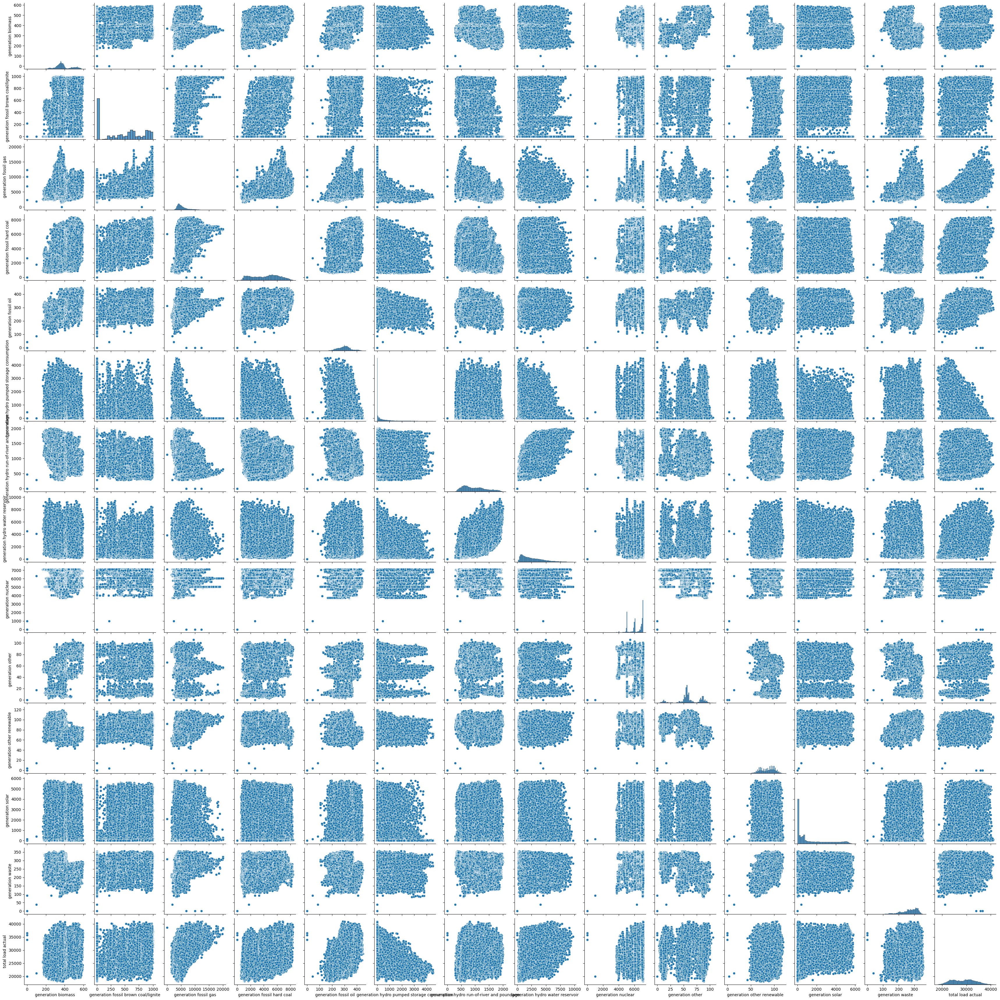

In [32]:
sns.pairplot(data[energy_cols+[target_variable]])

## Heatmap

In [33]:
def plot_heatmap(corr, save_path=None):
    plt.figure(figsize=(25,25))  # wider and taller

    sns.heatmap(corr, 
                annot=False, 
                fmt=".2f", 
                cmap="coolwarm", 
                cbar=True)

    plt.xticks(rotation=90)   # rotate x labels
    plt.yticks(rotation=0)    # keep y labels horizontal
    plt.tight_layout()        # adjust layout to prevent clipping
    if save_path:
        plt.savefig(save_path)
    plt.show()

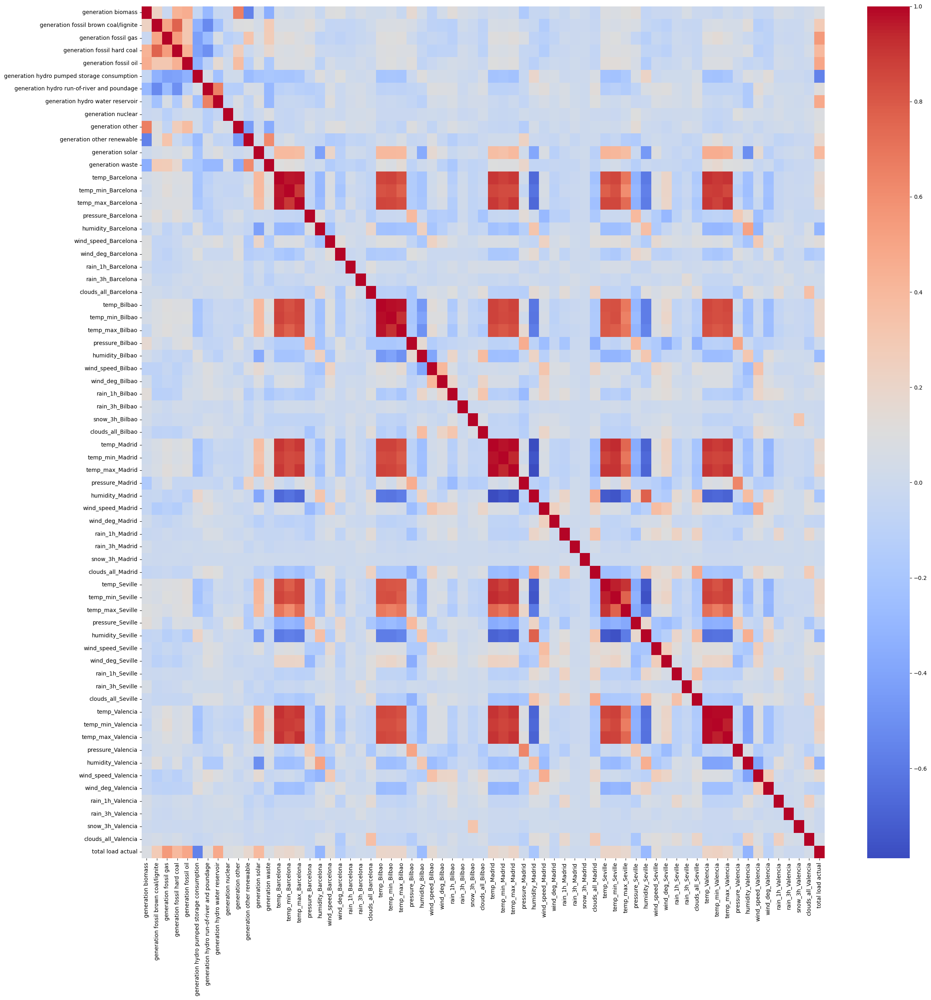

In [34]:
corr_expect_description = data[energy_cols+weather_cols_no_description+[target_variable]].corr()
plot_heatmap(corr_expect_description)

It show

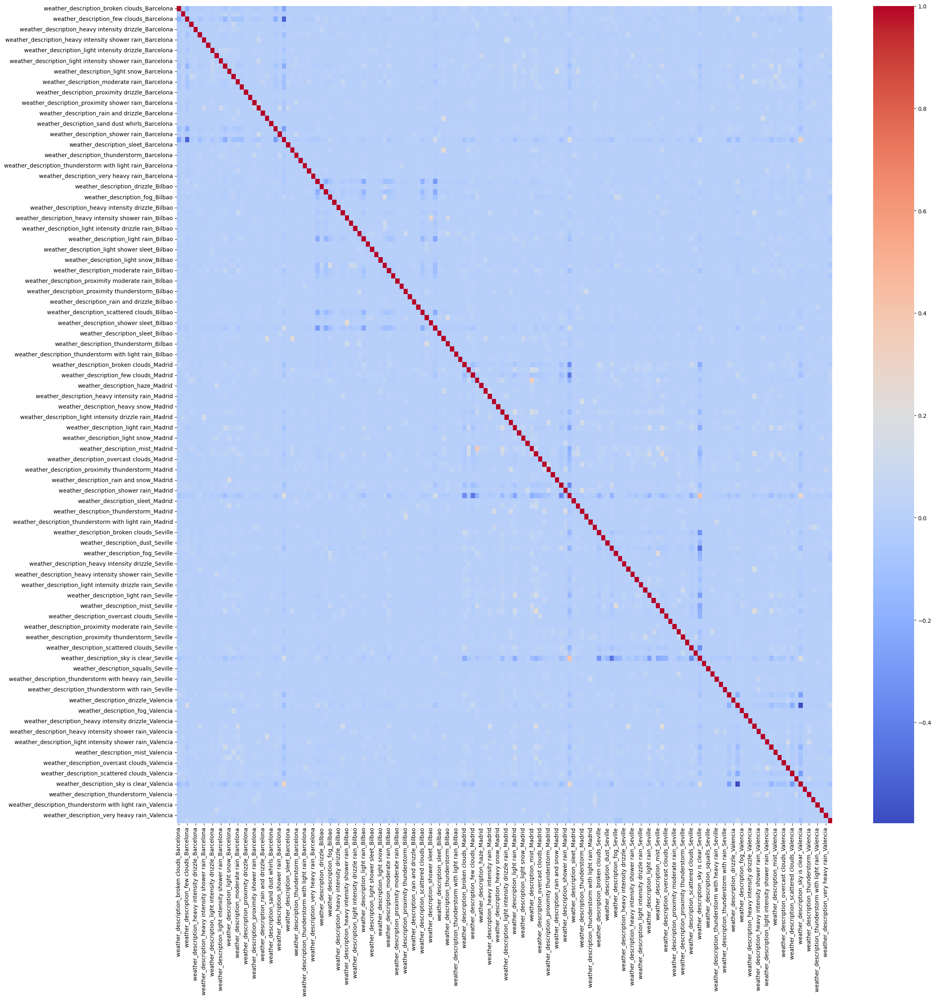

In [35]:
corr_description = data[weather_cols_description+[target_variable]].corr()
plot_heatmap(corr_description)

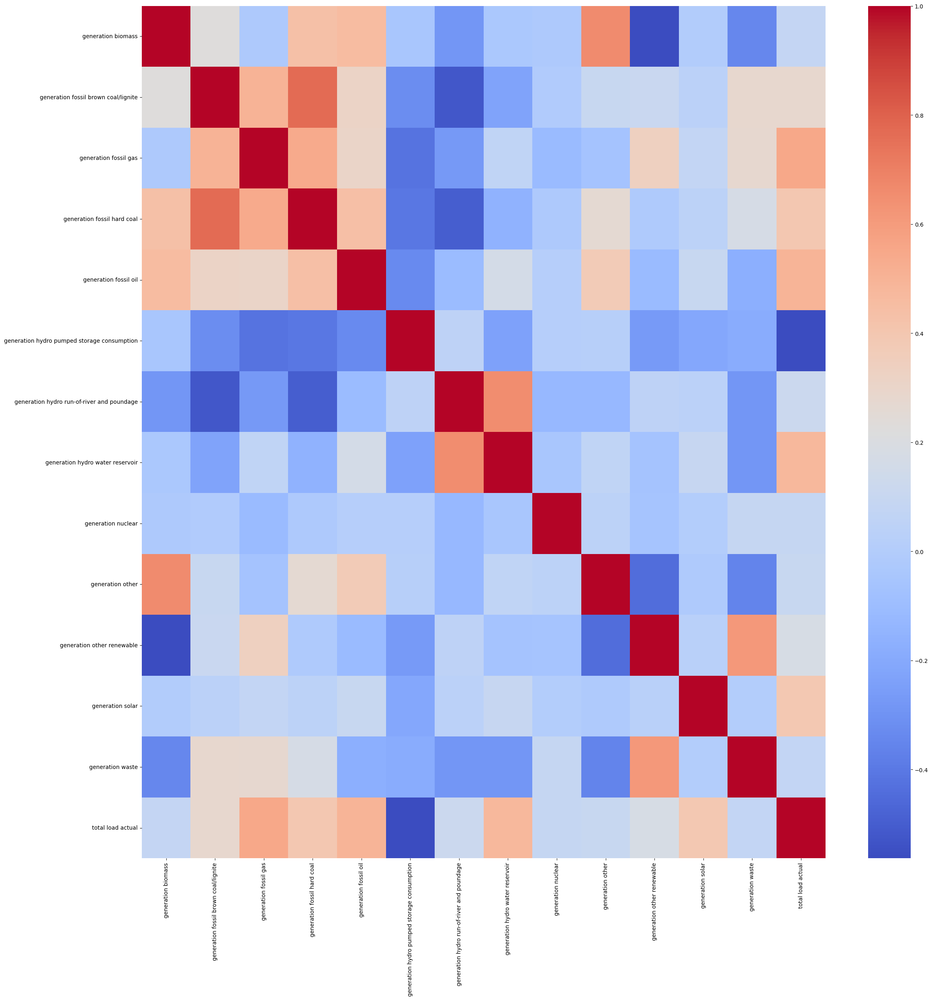

In [36]:
corr_energy = data[energy_cols+[target_variable]].corr()
plot_heatmap(corr_energy)

In [37]:
corr_pairs = corr_energy.stack().reset_index()
corr_pairs = corr_pairs.rename(columns={'level_0':'var1', 'level_1':'var2', 0:'corr'})
corr_pairs = corr_pairs[corr_pairs['var1'] != corr_pairs['var2']]
corr_pairs['sorted_pair'] = corr_pairs.apply(lambda x: tuple(sorted([x['var1'], x['var2']])), axis=1)
corr_pairs = corr_pairs.drop_duplicates(subset='sorted_pair').drop(columns='sorted_pair')
corr_pairs = corr_pairs.reindex(corr_pairs['corr'].abs().sort_values(ascending=False).index)
corr_pairs

,var1,var2,corr
17,generation fossil brown coal/lignite,generation fossil hard coal,0.768831
9,generation biomass,generation other,0.658408
91,generation hydro run-of-river and poundage,generation hydro water reservoir,0.652724
152,generation other renewable,generation waste,0.614009
83,generation hydro pumped storage consumption,total load actual,-0.562930
...,...,...,...
78,generation hydro pumped storage consumption,generation nuclear,0.012419
22,generation fossil brown coal/lignite,generation nuclear,-0.007572
11,generation biomass,generation solar,-0.004730
123,generation nuclear,generation solar,0.003911


In [38]:
corr_pairs[
    (corr_pairs['var1']=='total load actual')|
    (corr_pairs['var2']=='total load actual')
]

,var1,var2,corr
83,generation hydro pumped storage consumption,total load actual,-0.562930
41,generation fossil gas,total load actual,0.548972
69,generation fossil oil,total load actual,0.496126
111,generation hydro water reservoir,total load actual,0.479439
55,generation fossil hard coal,total load actual,0.397062
167,generation solar,total load actual,0.395542
27,generation fossil brown coal/lignite,total load actual,0.280752
153,generation other renewable,total load actual,0.180830
97,generation hydro run-of-river and poundage,total load actual,0.118460
139,generation other,total load actual,0.100697


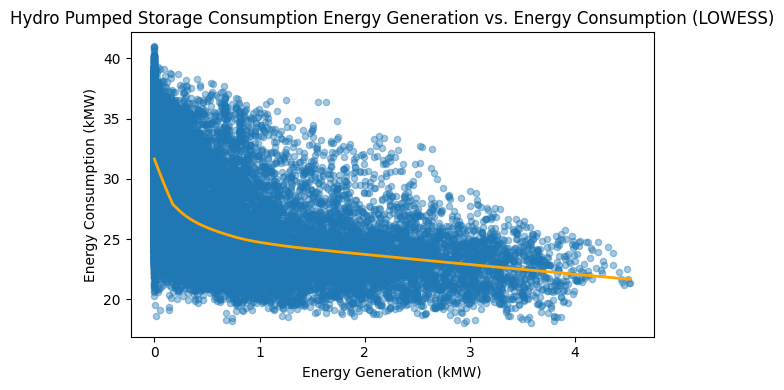

In [39]:
plt.figure(figsize=(6,4))
sns.regplot(
    data=data/1000,
    x="generation hydro pumped storage consumption",
    y="total load actual",
    lowess=True,
    scatter_kws={"s": 20, "alpha": 0.4},
    line_kws={"linewidth": 2, "color": "orange"}
)
plt.title("Hydro Pumped Storage Consumption Energy Generation vs. Energy Consumption (LOWESS)")
plt.xlabel("Energy Generation (kMW)")
plt.ylabel("Energy Consumption (kMW)")
plt.tight_layout()
plt.show()

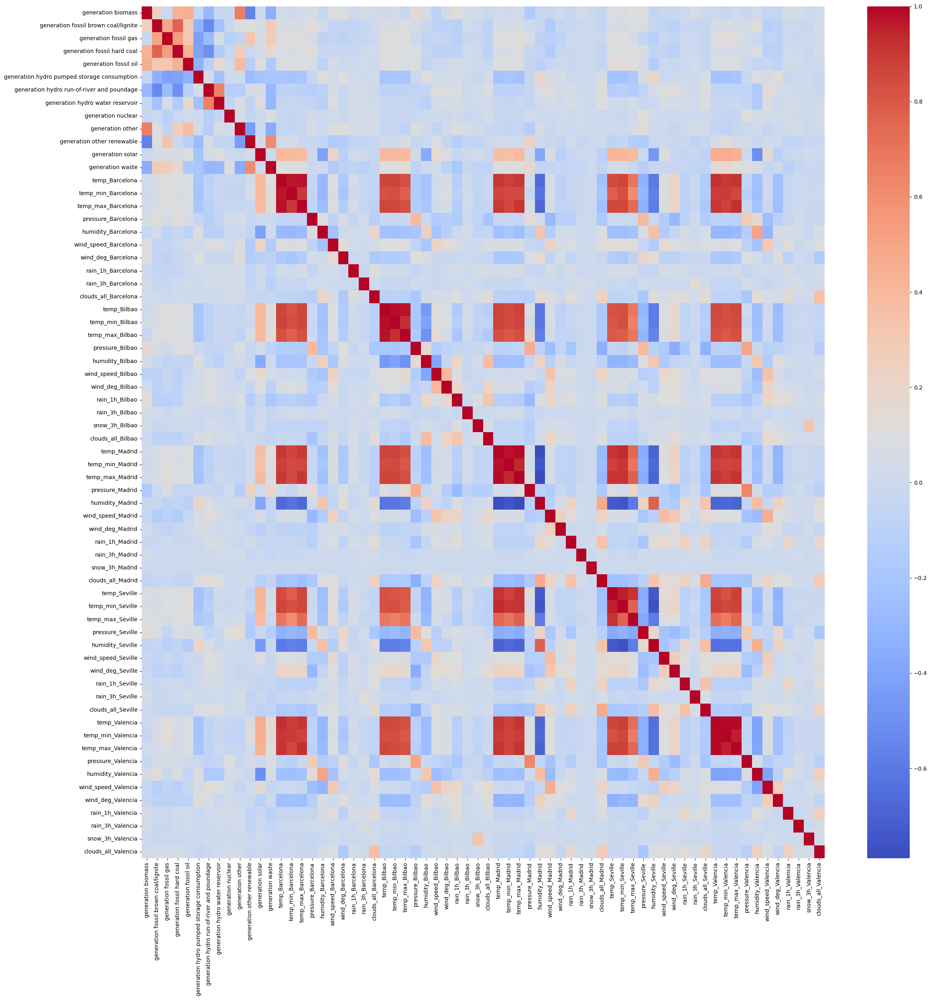

In [40]:
corr_weather_generation = data[energy_cols+weather_cols_no_description].corr()
plot_heatmap(corr_weather_generation, 'corr_weather_generation.png')

In [41]:
generation_weather_corr = data[energy_cols+weather_cols].corr()

In [42]:
generation_weather_corr

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,...,weather_description_proximity thunderstorm_Valencia,weather_description_scattered clouds_Valencia,weather_description_shower rain_Valencia,weather_description_sky is clear_Valencia,weather_description_smoke_Valencia,weather_description_thunderstorm_Valencia,weather_description_thunderstorm with heavy rain_Valencia,weather_description_thunderstorm with light rain_Valencia,weather_description_thunderstorm with rain_Valencia,weather_description_very heavy rain_Valencia
generation biomass,1.000000,0.230039,-0.021520,0.433734,0.459584,-0.045069,-0.284663,-0.033307,-0.021053,0.658408,...,-0.013028,0.005385,-0.008427,0.051907,0.003674,-0.002853,0.001662,-0.009765,-0.002509,0.011492
generation fossil brown coal/lignite,0.230039,1.000000,0.499902,0.768831,0.314900,-0.324051,-0.524721,-0.228836,-0.007572,0.097961,...,0.010638,0.004734,0.006670,-0.020922,-0.000471,0.001378,0.007454,0.008218,0.003285,0.005764
generation fossil gas,-0.021520,0.499902,1.000000,0.541684,0.309538,-0.420752,-0.271493,0.060344,-0.112292,-0.066013,...,-0.000421,-0.017314,0.012828,-0.038367,0.036057,0.007008,-0.003258,0.005179,0.007073,-0.001136
generation fossil hard coal,0.433734,0.768831,0.541684,1.000000,0.440842,-0.406317,-0.497578,-0.157031,-0.023150,0.264626,...,0.005183,0.003128,0.010105,-0.003967,0.006282,0.009727,0.002784,0.006493,0.006631,0.012037
generation fossil oil,0.459584,0.314900,0.309538,0.440842,1.000000,-0.330949,-0.106446,0.160743,0.015426,0.374782,...,-0.013063,-0.003424,0.005488,0.017650,0.010958,-0.007181,0.006980,0.006767,-0.000782,0.008799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
weather_description_thunderstorm_Valencia,-0.002853,0.001378,0.007008,0.009727,-0.007181,-0.010987,0.002736,-0.008798,-0.013312,-0.004247,...,-0.001533,-0.013362,0.091637,-0.036920,-0.000542,1.000000,-0.000585,-0.001232,-0.001061,-0.000542
weather_description_thunderstorm with heavy rain_Valencia,0.001662,0.007454,-0.003258,0.002784,0.006980,0.002064,0.002653,-0.003056,-0.006185,0.005727,...,-0.000523,-0.004561,-0.000420,-0.012601,-0.000185,-0.000585,1.000000,-0.000420,-0.000362,-0.000185
weather_description_thunderstorm with light rain_Valencia,-0.009765,0.008218,0.005179,0.006493,0.006767,-0.010824,0.003481,0.000495,-0.011170,-0.004362,...,-0.001101,-0.009601,-0.000885,-0.026527,-0.000389,-0.001232,-0.000420,1.000000,-0.000762,-0.000389
weather_description_thunderstorm with rain_Valencia,-0.002509,0.003285,0.007073,0.006631,-0.000782,-0.004459,0.001447,-0.002468,-0.001010,0.001310,...,-0.000949,-0.008269,-0.000762,-0.022846,-0.000335,-0.001061,-0.000362,-0.000762,1.000000,-0.000335


In [43]:
corr_pairs = generation_weather_corr.stack().reset_index()
corr_pairs = corr_pairs.rename(columns={'level_0':'var1', 'level_1':'var2', 0:'corr'})
corr_pairs = corr_pairs[corr_pairs['var1'] != corr_pairs['var2']]
corr_pairs['sorted_pair'] = corr_pairs.apply(lambda x: tuple(sorted([x['var1'], x['var2']])), axis=1)
corr_pairs = corr_pairs.drop_duplicates(subset='sorted_pair').drop(columns='sorted_pair')
corr_pairs = corr_pairs.reindex(corr_pairs['corr'].abs().sort_values(ascending=False).index)

In [44]:
corr_pairs[
    ((corr_pairs['var1'].str.contains('generation')) &
    (~corr_pairs['var2'].str.contains('generation')))|
    ((corr_pairs['var2'].str.contains('generation')) &
    (~corr_pairs['var1'].str.contains('generation')))
]

,var1,var2,corr
2621,generation solar,humidity_Valencia,-0.504770
2618,generation solar,temp_min_Valencia,0.459374
2617,generation solar,temp_Valencia,0.456586
2580,generation solar,humidity_Seville,-0.454908
2619,generation solar,temp_max_Valencia,0.439915
...,...,...,...
985,generation fossil oil,weather_description_thunderstorm with rain_Bilbao,-0.000011
2234,generation other renewable,weather_description_drizzle_Barcelona,-0.000011
694,generation fossil hard coal,weather_description_light intensity drizzle_Ba...,0.000007
144,generation biomass,weather_description_thunderstorm with rain_Madrid,-0.000006


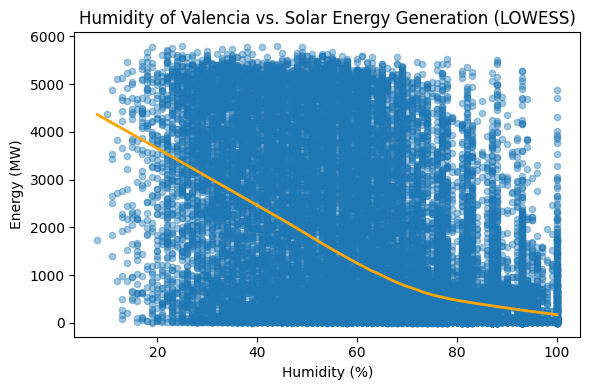

In [45]:
plt.figure(figsize=(6,4))
sns.regplot(
    data=data,
    x="humidity_Valencia",
    y="generation solar",
    lowess=True,
    scatter_kws={"s": 20, "alpha": 0.4},
    line_kws={"linewidth": 2, "color": "orange"}
)
plt.title("Humidity of Valencia vs. Solar Energy Generation (LOWESS)")
plt.xlabel("Humidity (%)")
plt.ylabel("Energy (MW)")
plt.tight_layout()
plt.show()


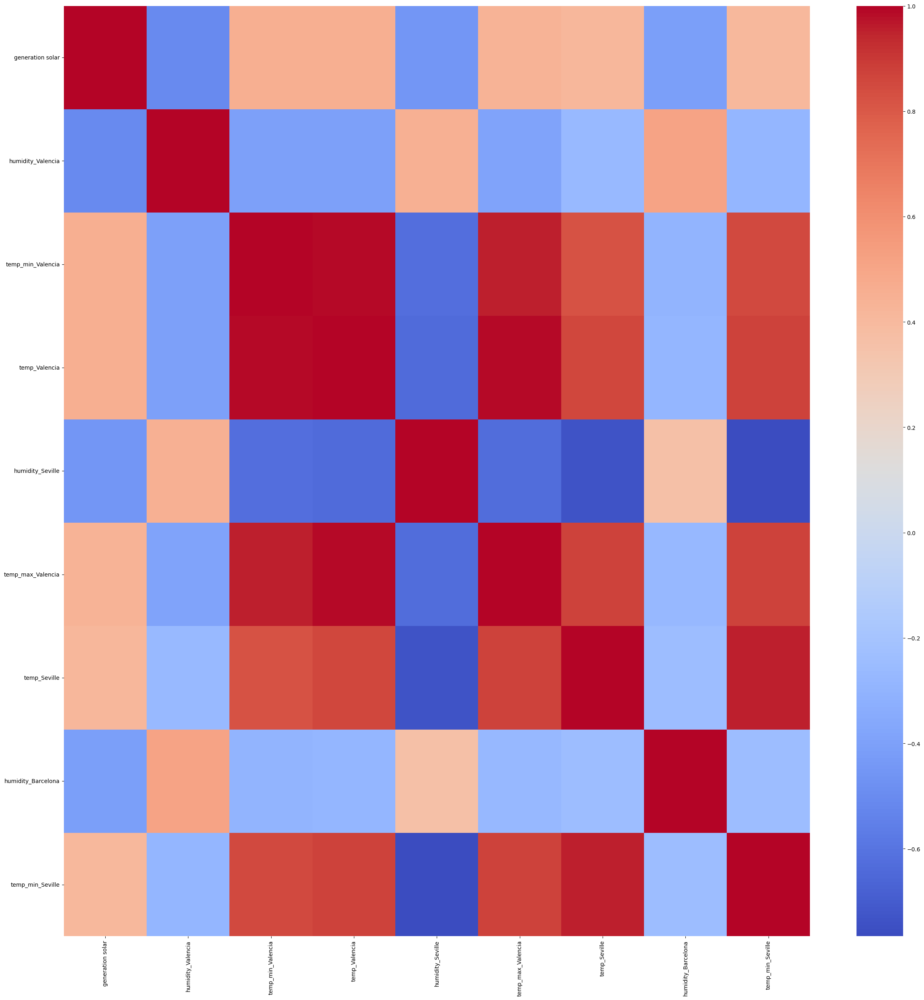

In [46]:
solar_cols = ['generation solar', 'humidity_Valencia', 'temp_min_Valencia', 'temp_Valencia', 'humidity_Seville', 'temp_max_Valencia', 'temp_Seville', 'humidity_Barcelona', 'temp_min_Seville']
solar_corr = data[solar_cols].corr()
plot_heatmap(solar_corr)

In [47]:
corr_pairs[
    ((corr_pairs['var1'].str.contains('generation')) &
    (~corr_pairs['var2'].str.contains('generation')))|
    ((corr_pairs['var2'].str.contains('generation')) &
    (~corr_pairs['var1'].str.contains('generation')))
]


,var1,var2,corr
2621,generation solar,humidity_Valencia,-0.504770
2618,generation solar,temp_min_Valencia,0.459374
2617,generation solar,temp_Valencia,0.456586
2580,generation solar,humidity_Seville,-0.454908
2619,generation solar,temp_max_Valencia,0.439915
...,...,...,...
985,generation fossil oil,weather_description_thunderstorm with rain_Bilbao,-0.000011
2234,generation other renewable,weather_description_drizzle_Barcelona,-0.000011
694,generation fossil hard coal,weather_description_light intensity drizzle_Ba...,0.000007
144,generation biomass,weather_description_thunderstorm with rain_Madrid,-0.000006


In [48]:
weather_consumption_corr = data[weather_cols_no_description+[target_variable]].corr()

In [49]:
corr_pairs = weather_consumption_corr.stack().reset_index()
corr_pairs = corr_pairs.rename(columns={'level_0':'var1', 'level_1':'var2', 0:'corr'})
corr_pairs = corr_pairs[corr_pairs['var1'] != corr_pairs['var2']]
corr_pairs['sorted_pair'] = corr_pairs.apply(lambda x: tuple(sorted([x['var1'], x['var2']])), axis=1)
corr_pairs = corr_pairs.drop_duplicates(subset='sorted_pair').drop(columns='sorted_pair')
corr_pairs = corr_pairs.reindex(corr_pairs['corr'].abs().sort_values(ascending=False).index)

In [50]:
corr_pairs[
    (corr_pairs['var1']=='total load actual')|
    (corr_pairs['var2']=='total load actual')
]

,var1,var2,corr
2537,humidity_Valencia,total load actual,-0.314658
269,humidity_Barcelona,total load actual,-0.300813
1997,humidity_Seville,total load actual,-0.283113
809,humidity_Bilbao,total load actual,-0.268136
2375,temp_min_Valencia,total load actual,0.235337
2321,temp_Valencia,total load actual,0.220831
1835,temp_min_Seville,total load actual,0.206521
1295,temp_max_Madrid,total load actual,0.204755
1781,temp_Seville,total load actual,0.204612
1403,humidity_Madrid,total load actual,-0.201521


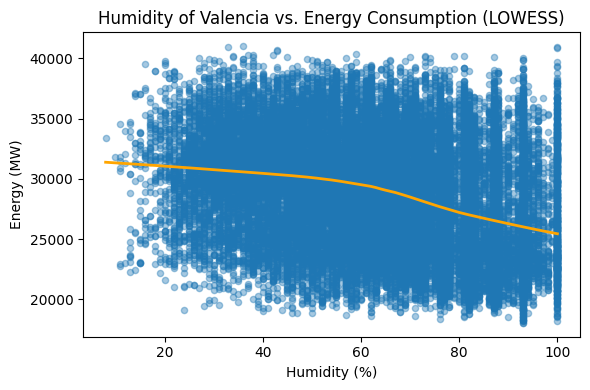

In [51]:
plt.figure(figsize=(6,4))
sns.regplot(
    data=data,
    x="humidity_Valencia",
    y="total load actual",
    lowess=True,
    scatter_kws={"s": 20, "alpha": 0.4},
    line_kws={"linewidth": 2, "color": "orange"}
)
plt.title("Humidity of Valencia vs. Energy Consumption (LOWESS)")
plt.xlabel("Humidity (%)")
plt.ylabel("Energy (MW)")
plt.tight_layout()
plt.show()

---